In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib as mpl

from matplotlib import pyplot as plt

%matplotlib inline
#mpl.style.use("seaborn")

print("Pandas Version: " + pd.__version__)
print("Numpy Version: " + np.__version__)
print("Seaborn Version: " + sns.__version__)

Pandas Version: 1.2.4
Numpy Version: 1.18.5
Seaborn Version: 0.11.1


In [2]:
users = pd.read_csv("../data/clean/users.csv", parse_dates=["date_from_min", "date_from_max"], index_col="user_id")
users.head(3)

,date_from_min,date_from_max,trips_count,active_period_in_days,days_since_first_activity,days_since_last_activity,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh,trips_per_day,mean_time_between_trips
user_id,,,,,,,,,,,
0000020B772C8D71F4F9AE4835D6C9F032FDBE21,2014-08-03 00:43:54,2017-05-12 19:42:34,66,1013,1017,3,12.393939,1.685233,8.385693,15.348485,22 days 12:41:03.644444444
000004354587D5BAC99A2171DE2F4ACD30AA8635,2014-03-10 08:42:55,2016-11-17 12:11:25,8,983,1162,179,15.625000,1.089574,4.221271,122.875000,163 days 20:34:22.500000
00005721E978458AD348C24219138429BC84574A,2016-06-19 21:02:32,2017-05-15 16:05:15,99,329,330,0,10.252525,1.454124,8.849686,3.323232,4 days 09:31:51.706666666


In [3]:
users.describe()

,trips_count,active_period_in_days,days_since_first_activity,days_since_last_activity,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh,trips_per_day
count,192206.000000,192206.000000,192206.000000,192206.000000,192206.000000,191045.000000,191045.000000,192206.000000
mean,39.335182,464.901632,794.882928,329.551835,15.690634,1.964790,7.681129,29.655940
std,83.189845,413.576799,368.205320,337.607509,4.642862,0.753423,1.804267,45.920738
min,2.000000,0.000000,0.000000,0.000000,2.088652,0.105816,0.198404,0.000000
25%,5.000000,54.000000,433.000000,35.000000,12.469598,1.437638,6.586857,3.386246
50%,14.000000,366.000000,933.000000,235.000000,15.421053,1.878703,7.808227,13.760000
75%,39.000000,840.000000,1127.000000,586.000000,18.619048,2.388693,8.894262,36.193238
max,2712.000000,1230.000000,1231.000000,1231.000000,33.000000,7.891597,14.924683,610.000000


In [4]:
users["trips_per_day"] = users["active_period_in_days"] / users["trips_count"]
users["trips_per_day"].describe()

count    192206.000000
mean         29.655940
std          45.920738
min           0.000000
25%           3.386246
50%          13.760000
75%          36.193238
max         610.000000
Name: trips_per_day, dtype: float64

In [5]:
users["mean_time_between_trips_in_hours"] = users["mean_time_between_trips"] / np.timedelta64(1, "h")

In [8]:
def display_distribution(attribute, bins=150):
    values = users[[attribute]]
    plt.figure(figsize=(16,5))
    plt.hist(values, alpha=0.7, bins=bins)
    plt.xlabel(attribute)
    plt.ylabel("count")
    plt.savefig("figures/users_hist_%s"%attribute, bbox_inches="tight")
    plt.show()

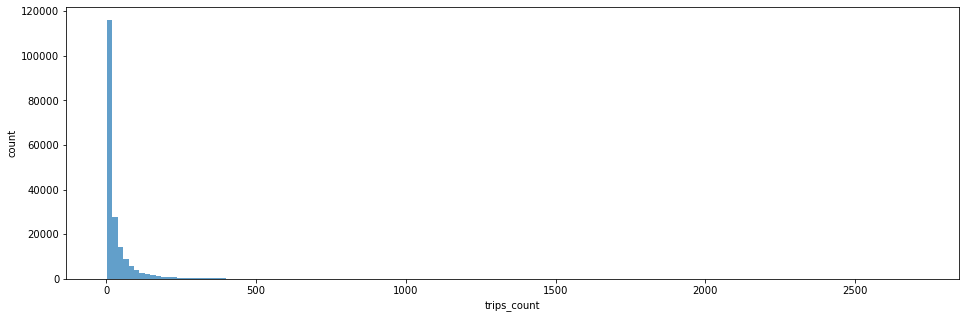

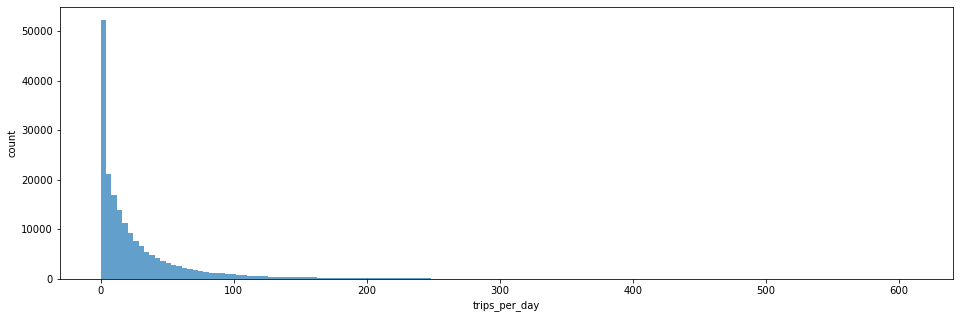

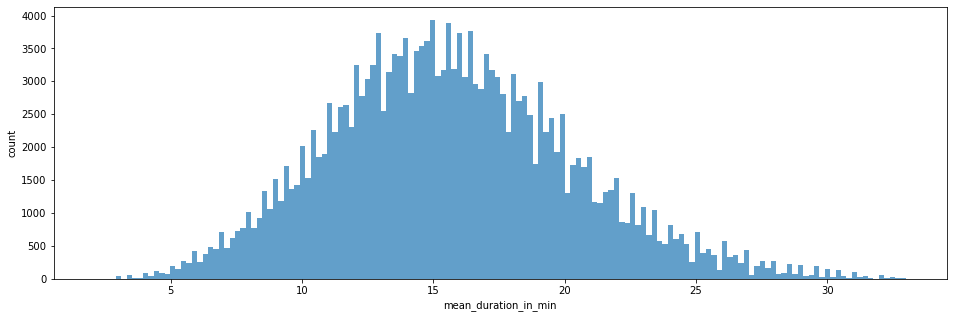

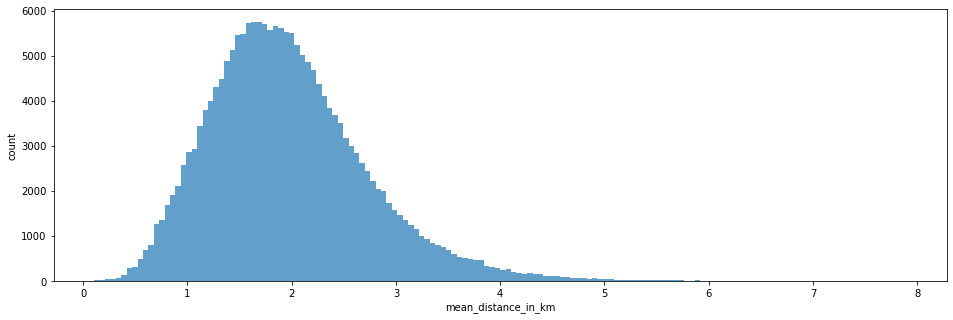

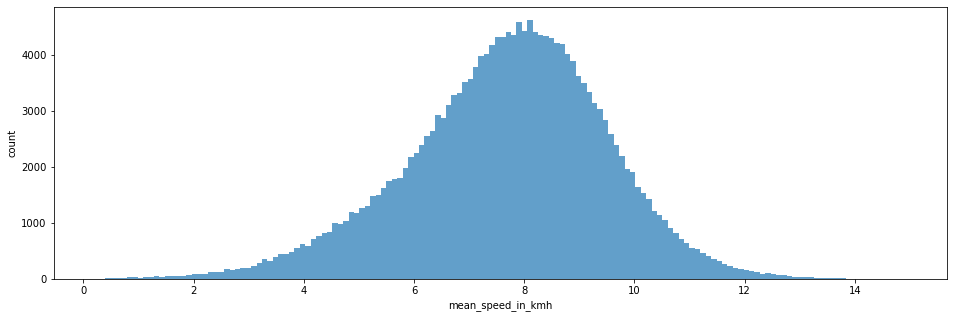

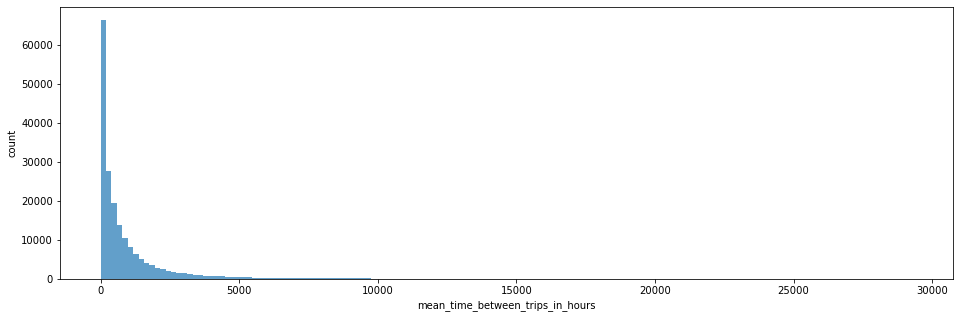

In [12]:
attributes = [
    "trips_count",
    "trips_per_day",
    "mean_duration_in_min",
    "mean_distance_in_km",
    "mean_speed_in_kmh",
    "mean_time_between_trips_in_hours"
]

for attribute in attributes:
    display_distribution(attribute)

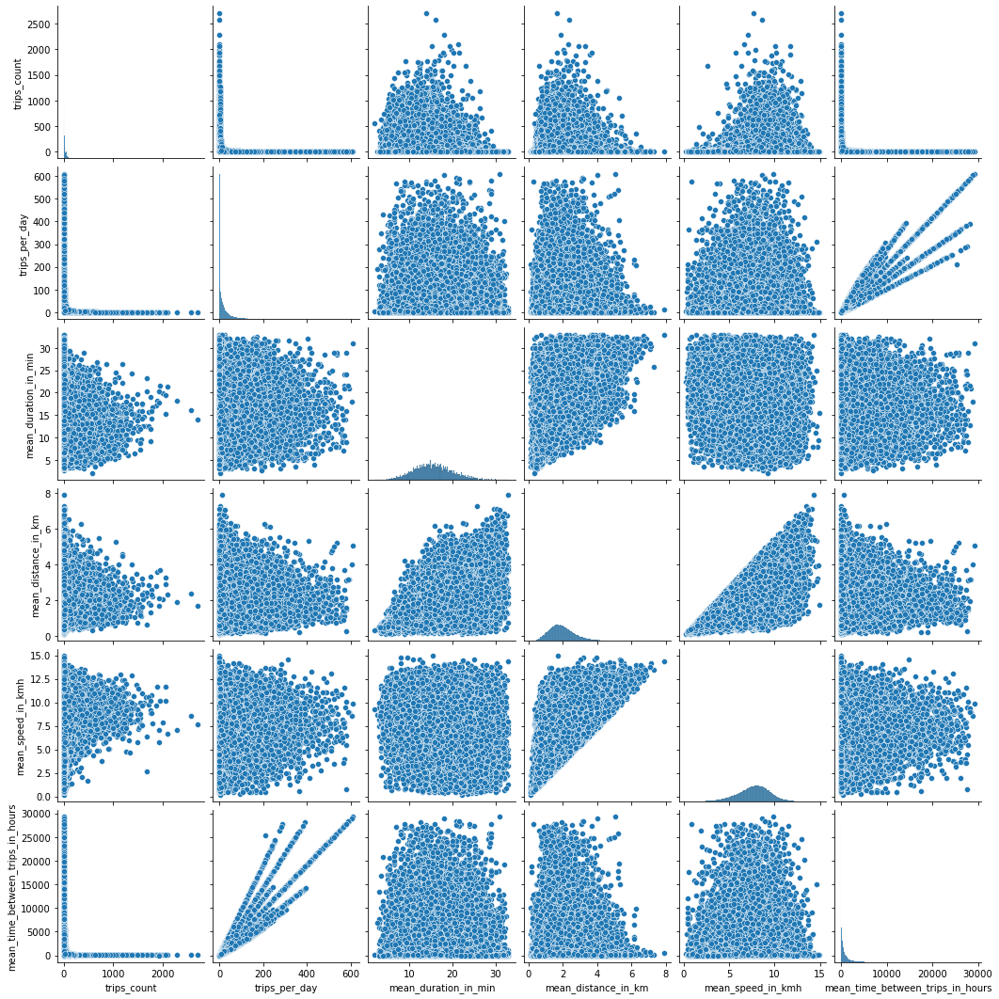

In [10]:
sns.pairplot(
    users[[
        "trips_count",
        "trips_per_day",
        "mean_duration_in_min",
        "mean_distance_in_km",
        "mean_speed_in_kmh",
        "mean_time_between_trips_in_hours",
    ]]
)